<a href="https://colab.research.google.com/github/Aarij00/deforestation-predictor/blob/main/Deforestation_Model_Pipeline.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports and Authentications


In [1]:
import folium
import numpy as np
import ee
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.utils import resample
from scipy.ndimage import gaussian_filter

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
drive.flush_and_unmount()
drive.mount("/content/drive", force_remount=True)

Mounted at /content/drive


In [ ]:
# Initialize Earth Engine
ee.Authenticate()
ee.Initialize(project = 'deforestation-450200')



# Earth Engine + Other Datasets Image Set Up

In [ ]:
roi = ee.Geometry.Polygon([
    [
        [-122.8, 48.9],
        [-113.5, 48.9],
        [-113.5, 54.5],
        [-122.8, 54.5],
        [-122.8, 48.9]
    ]
    ])

In [ ]:
# Function to get median composite
years = list(range(2001, 2024))  # 2001–2023

def get_annual_composites(years, roi):
    composites = {}
    for year in years:
        start = f"{year}-01-01"
        end = f"{year}-12-31"
        img = (
            ee.ImageCollection("COPERNICUS/S2")
            .filterBounds(roi)
            .filterDate(start, end)
            .filterMetadata("CLOUDY_PIXEL_PERCENTAGE", "less_than", 20)
            .select(["B2", "B3", "B4", "B8"])
            .median()
            .clip(roi)
        )
        composites[year] = img
    return composites

yearly_composites = get_annual_composites(years, roi)



/usr/local/lib/python3.11/dist-packages/ee/deprecation.py:207: DeprecationWarning: 

Attention required for COPERNICUS/S2! You are using a deprecated asset.
To make sure your code keeps working, please update it.
Learn more: https://developers.google.com/earth-engine/datasets/catalog/COPERNICUS_S2

  warnings.warn(warning, category=DeprecationWarning)


In [ ]:
# Compute delta bands (year-to-year changes)
delta_dict = {}

for year in range(2003, 2024):  # Start from second year
    current = yearly_composites[year]
    prev = yearly_composites[year - 2]
    last = yearly_composites[year - 1]
    # B4 and B8 deltas
    delta_b4 = current.select("B4").subtract(prev.select("B4")).rename(f"delta_b4")
    delta_b8 = current.select("B8").subtract(prev.select("B8")).rename(f"delta_b8")


    # NDVI delta
    ndvi_curr = current.normalizedDifference(["B8", "B4"]).rename("NDVI")
    ndvi_prev = prev.normalizedDifference(["B8", "B4"]).rename("NDVI")
    ndvi_last = last.normalizedDifference(["B8", "B4"])
    delta_ndvi = current.normalizedDifference(["B8", "B4"]).subtract(
      prev.normalizedDifference(["B8", "B4"])
    ).rename(f"delta_ndvi")

    delta_2yr = ndvi_curr.subtract(ndvi_prev).rename(f"NDVI_2yr_delta")
    trend = ndvi_curr.add(ndvi_last).add(ndvi_prev).divide(3).rename(f"NDVI_trend")
    # NDWI delta
    ndwi_curr = current.normalizedDifference(["B3", "B8"]).rename("NDWI")
    ndwi_prev = last.normalizedDifference(["B3", "B8"]).rename("NDWI")
    delta_ndwi = current.normalizedDifference(["B3", "B8"]).subtract(
        prev.normalizedDifference(["B3", "B8"])
    ).rename(f"delta_ndwi")

    #  Store in dictionary
    delta_dict[year] = {
        f"delta_B4_{year}": delta_b4,
        f"delta_B8_{year}": delta_b8,
        f"delta_NDVI_{year}": delta_ndvi,
        f"delta_NDWI_{year}": delta_ndwi,
        f"NDVI_trend_{year}": delta_2yr,
        f"NDVI_2yr_delta_{year}": trend
    }
#  Final composite (long-term median)
composite = (
    ee.ImageCollection("COPERNICUS/S2")
    .filterBounds(roi)
    .filterDate("2003-01-01", "2023-12-31")
    .filterMetadata("CLOUDY_PIXEL_PERCENTAGE", "less_than", 20)
    .select(["B2", "B3", "B4", "B8"])
    .median()
    .clip(roi)
)
print(delta_dict)
#  Vegetation indices from long-term median
ndvi = composite.normalizedDifference(["B8", "B4"]).rename("NDVI")
ndwi = composite.normalizedDifference(["B3", "B8"]).rename("NDWI")


{2003: {'delta_B4_2003': <ee.image.Image object at 0x7a93375bc390>, 'delta_B8_2003': <ee.image.Image object at 0x7a93375b3d90>, 'delta_NDVI_2003': <ee.image.Image object at 0x7a93375b2a50>, 'delta_NDWI_2003': <ee.image.Image object at 0x7a93375b1c90>, 'NDVI_trend_2003': <ee.image.Image object at 0x7a93375b2610>, 'NDVI_2yr_delta_2003': <ee.image.Image object at 0x7a93375b26d0>}, 2004: {'delta_B4_2004': <ee.image.Image object at 0x7a93375b1450>, 'delta_B8_2004': <ee.image.Image object at 0x7a93375b10d0>, 'delta_NDVI_2004': <ee.image.Image object at 0x7a93375b06d0>, 'delta_NDWI_2004': <ee.image.Image object at 0x7a93375a7b90>, 'NDVI_trend_2004': <ee.image.Image object at 0x7a93375b0210>, 'NDVI_2yr_delta_2004': <ee.image.Image object at 0x7a93375a7d90>}, 2005: {'delta_B4_2005': <ee.image.Image object at 0x7a93375a7590>, 'delta_B8_2005': <ee.image.Image object at 0x7a93375a7110>, 'delta_NDVI_2005': <ee.image.Image object at 0x7a93375a6a10>, 'delta_NDWI_2005': <ee.image.Image object at 0x7a9

In [ ]:
# Forest mask
gfc = ee.Image("UMD/hansen/global_forest_change_2023_v1_11").clip(roi)
treecover = gfc.select("treecover2000")
lossyear = gfc.select("lossyear")
loss = gfc.select("loss")        # 1 = forest loss occurred
gain = gfc.select("gain")        # 1 = forest gain occurred

dw = ee.ImageCollection("GOOGLE/DYNAMICWORLD/V1")



In [ ]:
roads = ee.FeatureCollection('TIGER/2016/Roads')
roads = roads.filterBounds(roi)
road_raster = roads \
    .reduceToImage(properties=['RTTYP'], reducer=ee.Reducer.first()) \
    .gt(0) \
    .rename('roads_binary')

distance_to_roads = road_raster \
    .Not() \
    .fastDistanceTransform(250).sqrt() \
    .rename('distance_to_roads')

In [ ]:
# Dictionary to hold enhanced images per year
enhanced_composites = {}
# Elevation and slope
dem = ee.Image("USGS/SRTMGL1_003").select("elevation")
slope = ee.Terrain.slope(dem).rename("slope")
dw_classes = [
    'water', 'trees', 'grass', 'flooded_vegetation',
    'crops', 'shrub_and_scrub', 'built', 'bare', 'snow_and_ice'
]

for year in range(2020, 2024):  # or 2001–2023 if needed
    year_str = str(year)
    img = yearly_composites[year]
    dw_year = dw.filterDate(f"{year}-01-01", f"{year}-12-31").filterBounds(roi)
    # List of Dynamic World class bands
      #  Take the median composite of the probabilities
    dw_median = dw_year.select(dw_classes).median()
    dw_median = dw_median.rename([f"dw_{b}" for b in dw_classes])

    ndvi = img.normalizedDifference(["B8", "B4"]).rename("NDVI")
    ndwi = img.normalizedDifference(["B3", "B8"]).rename("NDWI")
    recent_loss = lossyear.gte(year - 2000 - 2).And(lossyear.lte(year - 2000)).rename(f"recent_loss")

    ndvi_stddev_3x3 = ndvi.reduceNeighborhood(
        reducer=ee.Reducer.stdDev(), kernel=ee.Kernel.square(1)
    ).rename("NDVI_stddev_3x3")

    ndvi_stddev_5x5 = ndvi.reduceNeighborhood(
        reducer=ee.Reducer.stdDev(), kernel=ee.Kernel.square(2)
    ).rename("NDVI_stddev_5x5")

    slope_stddev_3x3 = slope.reduceNeighborhood(
        reducer=ee.Reducer.stdDev(), kernel=ee.Kernel.square(1)
    ).rename("slope_stddev_3x3")

    slope_stddev_5x5 = slope.reduceNeighborhood(
        reducer=ee.Reducer.stdDev(), kernel=ee.Kernel.square(2)
    ).rename("slope_stddev_5x5")
    delta_b4 = delta_dict[year][f"delta_B4_{year}"]
    delta_b8 = delta_dict[year][f"delta_B8_{year}"]
    delta_ndvi = delta_dict[year][f"delta_NDVI_{year}"]
    delta_ndwi = delta_dict[year][f"delta_NDWI_{year}"]
    delta_2yr = delta_dict[year][f"NDVI_2yr_delta_{year}"]
    trend = delta_dict[year][f"NDVI_trend_{year}"]
    # Combine all bands
    enhanced = img \
        .addBands(ndvi) \
        .addBands(ndwi) \
        .addBands(dem.rename("elevation")) \
        .addBands(slope) \
        .addBands(ndvi_stddev_3x3) \
        .addBands(ndvi_stddev_5x5) \
        .addBands(slope_stddev_3x3) \
        .addBands(slope_stddev_5x5) \
        .addBands(gain.rename("gain")) \
        .addBands(delta_b4) \
        .addBands(delta_b8) \
        .addBands(delta_ndvi) \
        .addBands(delta_ndwi) \
        .addBands(recent_loss) \
        .addBands(loss.rename("loss")) \
        .addBands(lossyear.rename("lossyear")) \
        .addBands(delta_2yr) \
        .addBands(dw_median) \
        .addBands(distance_to_roads.rename("distance_to_roads")) \
        .addBands(trend)

    # Apply tree cover mask
    masked = enhanced.updateMask(treecover.gte(30))

    # Store
    enhanced_composites[year_str] = masked


# Export functions

In [ ]:
def export_annual_samples_to_drive(composites, bands, loss, base_roi, tile_count=2, scale=250, num_samples=2000):
    import ee

    fixed_proj = ee.Projection("EPSG:4326").atScale(scale)

    # Calculate tile bounds once
    coords = base_roi.bounds().coordinates().get(0).getInfo()
    xmin, ymin = coords[0][0], coords[0][1]
    xmax, ymax = coords[2][0], coords[2][1]
    x_step = (xmax - xmin) / tile_count
    y_step = (ymax - ymin) / tile_count

    tile_geoms = []
    for i in range(tile_count):
        for j in range(tile_count):
            tile = ee.Geometry.Rectangle([
                xmin + j * x_step,
                ymin + i * y_step,
                xmin + (j + 1) * x_step,
                ymin + (i + 1) * y_step
            ])
            tile_geoms.append(tile)

    task_id = 1

    # Use first year in the dictionary to generate reference points
    first_year = list(composites.keys())[0]
    first_image = composites[first_year].select(bands + ["loss"]).reproject(fixed_proj)

    reference_samples_by_tile = []

    print(f" Generating reference samples from year: {first_year}")

    for tile in tile_geoms:
        reference_sample = first_image.sample(
            region=tile,
            scale=scale,
            projection=fixed_proj,
            numPixels=num_samples,
            geometries=True,
            seed=task_id * 100
        ).limit(num_samples)
        reference_samples_by_tile.append(reference_sample)

    # Use reference samples to extract values from every year using sampleRegions
    for year, image in composites.items():
        print(f" Starting export for year: {year}")

        reprojected_image = image.select(bands + ["loss"]).reproject(fixed_proj)

        for tile_idx, reference_points in enumerate(reference_samples_by_tile, start=1):
            sampled = reprojected_image.sampleRegions(
                collection=reference_points,
                scale=scale,
                projection=fixed_proj,
                geometries=True
            )

            task = ee.batch.Export.table.toDrive(
                collection=sampled,
                description=f"{year}_tile_{tile_idx}",
                folder="test",
                fileNamePrefix=f"deforestation_tile_{year}_{tile_idx}",
                fileFormat="CSV"
            )
            task.start()
            print(f"Started export: Year {year} | Tile {tile_idx}")

    print("🚀 All exports started — check your Google Drive (earth_engine folder).")


In [ ]:
def export_annual_samples_no_overlap(composites, bands, loss, base_roi, tile_count=2, scale=250, num_samples=2000):
    import ee

    fixed_proj = ee.Projection("EPSG:4326").atScale(scale)

    #  Tile splitting logic
    coords = base_roi.bounds().coordinates().get(0).getInfo()
    xmin, ymin = coords[0][0], coords[0][1]
    xmax, ymax = coords[2][0], coords[2][1]
    x_step = (xmax - xmin) / tile_count
    y_step = (ymax - ymin) / tile_count

    tile_geoms = []
    for i in range(tile_count):
        for j in range(tile_count):
            tile = ee.Geometry.Rectangle([
                xmin + j * x_step,
                ymin + i * y_step,
                xmin + (j + 1) * x_step,
                ymin + (i + 1) * y_step
            ])
            tile_geoms.append(tile)

    task_id = 1

    #  For each year, independently sample each tile
    for year, image in composites.items():
        print(f" Starting export for year: {year}")

        reprojected_image = image.select(bands + ["loss"]).reproject(fixed_proj)

        for tile_idx, tile in enumerate(tile_geoms, start=1):
            sampled = reprojected_image.sample(
                region=tile,
                scale=scale,
                projection=fixed_proj,
                numPixels=num_samples,
                geometries=True,
                seed=(int(year) * 10000 + tile_idx)
            ).limit(num_samples)

            task = ee.batch.Export.table.toDrive(
                collection=sampled,
                description=f"{year}_tile_{tile_idx}",
                folder="no-overlap-data",  # Change to your preferred Drive folder
                fileNamePrefix=f"deforestation_tile_{year}_{tile_idx}",
                fileFormat="CSV"
            )
            if(int(year)== 2023 and tile_idx == 63):

              task.start()
              print(f" Started export: Year {year} | Tile {tile_idx}")

    print(" All exports started — check your Google Drive (test folder).")


In [17]:
bands = ["B2", "B3", "B4", "B8", "NDVI", "NDWI",
         "delta_b4", "delta_b8", "delta_ndvi",
         "delta_ndwi", "elevation", "slope","gain","NDVI_stddev_3x3","NDVI_stddev_5x5",
         "slope_stddev_3x3","slope_stddev_5x5", "lossyear", "NDVI_2yr_delta", "NDVI_trend", "recent_loss", "dw_water","dw_trees","dw_grass","dw_flooded_vegetation","dw_crops","dw_shrub_and_scrub","dw_built","dw_bare","dw_snow_and_ice", "distance_to_roads"]

In [ ]:
export_annual_samples_no_overlap(enhanced_composites, bands, loss, roi, tile_count=9)

📅 Starting export for year: 2020
📅 Starting export for year: 2021
📅 Starting export for year: 2022
📅 Starting export for year: 2023
✅ Started export: Year 2023 | Tile 63
🚀 All exports started — check your Google Drive (test folder).


In [ ]:
# Export sample data to Google Drive
# Export 4 tiles (2x2 grid) with 1000 samples each
export_annual_samples_to_drive(enhanced_composites, bands, loss, roi, tile_count=9)


# After downloading CSV, use pandas to load and process locally
# Example (outside EE):
# import pandas as pd
# df = pd.read_csv("deforestation_data.csv")
# X = df[bands].values
# y = (df["lossyear"] >= 5).astype(int).values  # 5+ corresponds to year 2005+

📌 Generating reference samples from year: 2020
📅 Starting export for year: 2020
✅ Started export: Year 2020 | Tile 1
✅ Started export: Year 2020 | Tile 2
✅ Started export: Year 2020 | Tile 3
✅ Started export: Year 2020 | Tile 4
✅ Started export: Year 2020 | Tile 5
✅ Started export: Year 2020 | Tile 6
✅ Started export: Year 2020 | Tile 7
✅ Started export: Year 2020 | Tile 8
✅ Started export: Year 2020 | Tile 9
✅ Started export: Year 2020 | Tile 10
✅ Started export: Year 2020 | Tile 11
✅ Started export: Year 2020 | Tile 12
✅ Started export: Year 2020 | Tile 13
✅ Started export: Year 2020 | Tile 14
✅ Started export: Year 2020 | Tile 15
✅ Started export: Year 2020 | Tile 16
✅ Started export: Year 2020 | Tile 17
✅ Started export: Year 2020 | Tile 18
✅ Started export: Year 2020 | Tile 19
✅ Started export: Year 2020 | Tile 20
✅ Started export: Year 2020 | Tile 21
✅ Started export: Year 2020 | Tile 22
✅ Started export: Year 2020 | Tile 23
✅ Started export: Year 2020 | Tile 24
✅ Started export:

# Data prep for classifier

In [18]:
import pandas as pd
import glob
import numpy as np
import ast
import json
all_years = []

for year in range(2020, 2024):
    # Use glob to get all matching tile files for the year
    tile_files = glob.glob(f"/content/drive/MyDrive/no-overlap-data/deforestation_tile_{year}_*.csv")
    print(tile_files)
    for file in tile_files:
        df = pd.read_csv(file)
        df["year"] = year  # Add a column for the year
        all_years.append(df)

# Concatenate all dataframes into one
df = pd.concat(all_years, ignore_index=True)

# Extract lon/lat from geometry column
def extract_coords(geom_str):
    try:
        geom = ast.literal_eval(geom_str)  # safely parse string to dict
        lon, lat = geom["coordinates"]
        return pd.Series({"longitude": lon, "latitude": lat})
    except:
        return pd.Series({"longitude": None, "latitude": None})

# Apply to DataFrame
df["latitude"] = df[".geo"].apply(lambda g: json.loads(g)["coordinates"][1])
df["longitude"] = df[".geo"].apply(lambda g: json.loads(g)["coordinates"][0])
display(df.head())
# Fix nulls and assign label
print(df.columns.tolist())
classifier_bands = [b for b in bands if (b != "lossyear" and b != "recent_loss")]    # includes lossyear
X_class = df[classifier_bands]
y_class = df["loss"].astype(int)

print(f"Total samples: {len(df)}")
print(f"Deforestation samples: {np.sum(y_class == 1)}")
print(f"No deforestation samples: {np.sum(y_class == 0)}")



['/content/drive/MyDrive/no-overlap-data/deforestation_tile_2020_1.csv', '/content/drive/MyDrive/no-overlap-data/deforestation_tile_2020_2.csv', '/content/drive/MyDrive/no-overlap-data/deforestation_tile_2020_6.csv', '/content/drive/MyDrive/no-overlap-data/deforestation_tile_2020_4.csv', '/content/drive/MyDrive/no-overlap-data/deforestation_tile_2020_7.csv', '/content/drive/MyDrive/no-overlap-data/deforestation_tile_2020_3.csv', '/content/drive/MyDrive/no-overlap-data/deforestation_tile_2020_5.csv', '/content/drive/MyDrive/no-overlap-data/deforestation_tile_2020_8.csv', '/content/drive/MyDrive/no-overlap-data/deforestation_tile_2020_10.csv', '/content/drive/MyDrive/no-overlap-data/deforestation_tile_2020_9.csv', '/content/drive/MyDrive/no-overlap-data/deforestation_tile_2020_11.csv', '/content/drive/MyDrive/no-overlap-data/deforestation_tile_2020_17.csv', '/content/drive/MyDrive/no-overlap-data/deforestation_tile_2020_16.csv', '/content/drive/MyDrive/no-overlap-data/deforestation_tile_

,system:index,B2,B3,B4,B8,NDVI,NDVI_2yr_delta,NDVI_stddev_3x3,NDVI_stddev_5x5,NDVI_trend,...,loss,lossyear,recent_loss,slope,slope_stddev_3x3,slope_stddev_5x5,.geo,year,latitude,longitude
0,6,819.0,615.0,378.0,1981.0,0.679525,0.011754,0.064439,0.098470,0.632245,...,1,14,0,25.130798,5.520061,6.477565,"{""type"":""Point"",""coordinates"":[-121.8491555071...",2020,49.335567,-121.849156
1,11,944.0,772.0,528.0,1881.0,0.561644,0.108143,0.044291,0.059973,0.514270,...,1,16,0,12.332183,2.387733,4.636631,"{""type"":""Point"",""coordinates"":[-121.9329282035...",2020,49.503605,-121.932928
2,17,1243.0,1130.0,1067.0,2452.0,0.393578,0.033450,0.180214,0.313342,0.388843,...,1,6,0,0.212207,3.221693,5.412124,"{""type"":""Point"",""coordinates"":[-122.6708004807...",2020,49.284492,-122.670800
3,19,831.0,652.0,376.0,2418.0,0.730852,0.031983,0.040522,0.055995,0.716385,...,0,12,0,11.275628,2.141509,3.533465,"{""type"":""Point"",""coordinates"":[-122.4157588306...",2020,49.239961,-122.415759
4,22,967.0,803.0,582.0,2271.0,0.592008,0.027613,0.038043,0.038430,0.583321,...,1,15,0,2.915691,2.759305,2.667499,"{""type"":""Point"",""coordinates"":[-122.5136819166...",2020,49.146610,-122.513682


['system:index', 'B2', 'B3', 'B4', 'B8', 'NDVI', 'NDVI_2yr_delta', 'NDVI_stddev_3x3', 'NDVI_stddev_5x5', 'NDVI_trend', 'NDWI', 'delta_b4', 'delta_b8', 'delta_ndvi', 'delta_ndwi', 'distance_to_roads', 'dw_bare', 'dw_built', 'dw_crops', 'dw_flooded_vegetation', 'dw_grass', 'dw_shrub_and_scrub', 'dw_snow_and_ice', 'dw_trees', 'dw_water', 'elevation', 'gain', 'loss', 'lossyear', 'recent_loss', 'slope', 'slope_stddev_3x3', 'slope_stddev_5x5', '.geo', 'year', 'latitude', 'longitude']
Total samples: 158739
Deforestation samples: 100791
No deforestation samples: 57948


In [19]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.utils import resample
import pandas as pd
import numpy as np

# Create lat-lon tuples for easier matching
df["latlon"] = list(zip(df["latitude"], df["longitude"]))

# Use classifier mask first
classifier_mask = df["loss"].isin([0, 1])  # Assuming binary classification
df_class = df[classifier_mask].copy()

#  Create full feature, label, coord sets for classification & regression
X_class = df_class[classifier_bands].values
y_class = df_class["loss"].astype(int).values
coords = df_class[["latitude", "longitude"]].values

#  Split by class
X_defor = X_class[y_class == 1]
X_nondefor = X_class[y_class == 0]
y_defor = y_class[y_class == 1]
y_nondefor = y_class[y_class == 0]
coords_defor = coords[y_class == 1]
coords_nondefor = coords[y_class == 0]

#  Downsample non-deforestation (with replacement if needed)
nondefor_df = pd.DataFrame(X_nondefor, columns=classifier_bands)
nondefor_df["label"] = y_nondefor
nondefor_df["lat"] = coords_nondefor[:, 0]
nondefor_df["lon"] = coords_nondefor[:, 1]

nondefor_down = nondefor_df.sample(n=len(X_defor), replace=True, random_state=42)
X_nondefor_down = nondefor_down[classifier_bands].values
y_nondefor_down = nondefor_down["label"].values
coords_nondefor_down = nondefor_down[["lat", "lon"]].values

#  Reassemble
X_class_bal = np.vstack([X_defor, X_nondefor_down])
y_class_bal = np.concatenate([y_defor, y_nondefor_down])
coords_bal = np.vstack([coords_defor, coords_nondefor_down])

#  Create latlon for matching
latlon_bal = list(zip(coords_bal[:, 0], coords_bal[:, 1]))

#  Match from df_class by latlon
df_class["latlon"] = list(zip(df_class["latitude"], df_class["longitude"]))
matched_df = df_class[df_class["latlon"].isin(latlon_bal)].copy()

#  Extract everything from matched_df
X_class_bal = matched_df[classifier_bands].values
y_class_bal = matched_df["loss"].astype(int).values
coords_bal = matched_df[["latitude", "longitude"]].values

# Scale
scaler_class = StandardScaler()
X_class_scaled = scaler_class.fit_transform(X_class_bal)

# Final split
Xc_train, Xc_test, yc_train, yc_test, coords_train, coords_test = train_test_split(
    X_class_scaled,y_class_bal, coords_bal,
    test_size=0.2, random_state=42
)




In [ ]:
import joblib

# Assuming you already fitted your scaler
joblib.dump(scaler_class, 'scaler_classifier_2.pkl')


['scaler_classifier_2.pkl']

In [ ]:
# Check how much overlap between train/test coordinates
train_coords_set = set(map(tuple, coords_train.round(5)))
test_coords_set = set(map(tuple, coords_test.round(5)))

overlap = len(train_coords_set.intersection(test_coords_set))
print(f"Overlapping coordinates between train/test: {overlap}")


Overlapping coordinates between train/test: 0


# Classifier parameters and training

In [20]:
import xgboost as xgb
from sklearn.metrics import accuracy_score

# Automatically compute class imbalance weight
scale_pos_weight = len(yc_train[yc_train == 0]) / len(yc_train[yc_train == 1])

# Updated XGBoost Classifier
classifier_model = xgb.XGBClassifier(
    n_estimators=1000,
    max_depth=10,
    learning_rate=0.03,
    subsample=0.9,
    colsample_bytree=0.85,
    min_child_weight=1,
    gamma=0.1,
    reg_alpha=0.5,
    reg_lambda=1.0,
    scale_pos_weight=scale_pos_weight,
    eval_metric='logloss',
    use_label_encoder=False,
    random_state=42
)


classifier_model.fit(Xc_train, yc_train, eval_set=[(Xc_test, yc_test)], verbose=True)


y_pred = classifier_model.predict(Xc_test)
print(f" XGBoost Accuracy: {accuracy_score(yc_test, y_pred):.2f}")



/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [03:34:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	validation_0-logloss:0.68591
[1]	validation_0-logloss:0.67912
[2]	validation_0-logloss:0.67267
[3]	validation_0-logloss:0.66671
[4]	validation_0-logloss:0.66087
[5]	validation_0-logloss:0.65530
[6]	validation_0-logloss:0.65012
[7]	validation_0-logloss:0.64530
[8]	validation_0-logloss:0.64061
[9]	validation_0-logloss:0.63614
[10]	validation_0-logloss:0.63190
[11]	validation_0-logloss:0.62769
[12]	validation_0-logloss:0.62390
[13]	validation_0-logloss:0.62013
[14]	validation_0-logloss:0.61653
[15]	validation_0-logloss:0.61312
[16]	validation_0-logloss:0.60991
[17]	validation_0-logloss:0.60680
[18]	validation_0-logloss:0.60375
[19]	validation_0-logloss:0.60096
[20]	validation_0-logloss:0.59825
[21]	validation_0-logloss:0.59568
[22]	validation_0-logloss:0.59321
[23]	validation_0-logloss:0.59082
[24]	validation_0-logloss:0.58849
[25]	validation_0-logloss:0.58625
[26]	validation_0-logloss:0.58417
[27]	validation_0-logloss:0.58217
[28]	validation_0-logloss:0.58020
[29]	validation_0-loglos

In [ ]:
probs = classifier_model.predict_proba(df[classifier_bands])[:, 1]  # Probability of class 1 (deforestation)
print(probs)
y_pred_class = classifier_model.predict(Xc_test)              # Predicted class (0 or 1)

# Prepare DataFrame with predictions and coordinates
df_preds = pd.DataFrame({
    'latitude': df["latitude"].values,
    'longitude': df["longitude"].values,
    'predicted_proba': probs
})

# Export to CSV
df_preds.to_csv('classifier_predictions_3.csv', index=False)

[0.48057842 0.5795514  0.53500587 ... 0.09301451 0.12312979 0.21731132]


In [ ]:
import joblib
joblib.dump(classifier_model, "xgb_classifier_model_2.pkl")


['xgb_classifier_model_2.pkl']

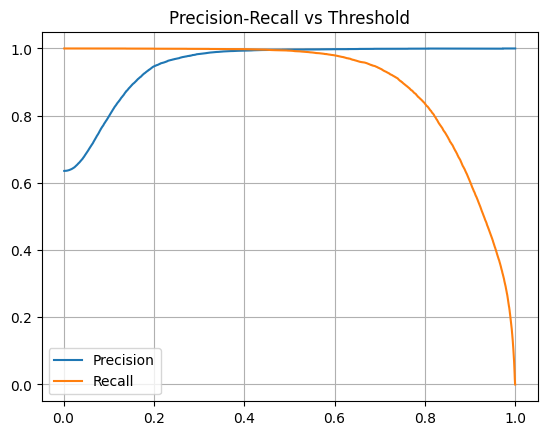

In [ ]:
from sklearn.metrics import precision_recall_curve

y_proba = classifier_model.predict_proba(Xc_test)[:,1]
prec, rec, thresholds = precision_recall_curve(yc_test, y_proba)

# Plot to choose best threshold
import matplotlib.pyplot as plt
plt.plot(thresholds, prec[:-1], label="Precision")
plt.plot(thresholds, rec[:-1], label="Recall")
plt.legend()
plt.grid()
plt.title("Precision-Recall vs Threshold")
plt.show()

In [ ]:
xgb_cv = xgb.cv(
    params=classifier_model.get_xgb_params(),
    dtrain=xgb.DMatrix(Xc_train, label=yc_train),
    num_boost_round=1000,
    nfold=5,
    metrics="logloss",
    early_stopping_rounds=50,
    verbose_eval=True
)

/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [00:47:36] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [00:47:37] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [00:47:38] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [00:47:39] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[0]	train-logloss:0.67886+0.00020	test-logloss:0.68051+0.00008
[1]	train-logloss:0.66653+0.00046	test-logloss:0.66972+0.00037
[2]	train-logloss:0.65614+0.00051	test-logloss:0.66075+0.00027
[3]	train-logloss:0.64686+0.00070	test-logloss:0.65298+0.00041
[4]	train-logloss:0.63758+0.00064	test-logloss:0.64517+0.00028
[5]	train-logloss:0.62960+0.00074	test-logloss:0.63854+0.00033
[6]	train-logloss:0.62270+0.00069	test-logloss:0.63301+0.00020
[7]	train-logloss:0.61592+0.00058	test-logloss:0.62759+0.00012
[8]	train-logloss:0.60983+0.00069	test-logloss:0.62282+0.00020
[9]	train-logloss:0.60467+0.00065	test-logloss:0.61891+0.00028
[10]	train-logloss:0.60049+0.00064	test-logloss:0.61609+0.00037
[11]	train-logloss:0.59577+0.00053	test-logloss:0.61260+0.00042
[12]	train-logloss:0.59143+0.00059	test-logloss:0.60942+0.00051
[13]	train-logloss:0.58706+0.00053	test-logloss:0.60631+0.00061
[14]	train-logloss:0.58321+0.00035	test-logloss:0.60361+0.00076
[15]	train-logloss:0.57947+0.00035	test-logloss:0.

📊 Classifier Evaluation:
✅ Accuracy:  0.7466
✅ Precision: 0.8531
✅ Recall:    0.7577
✅ F1 Score:  0.8026
🧩 Confusion Matrix:


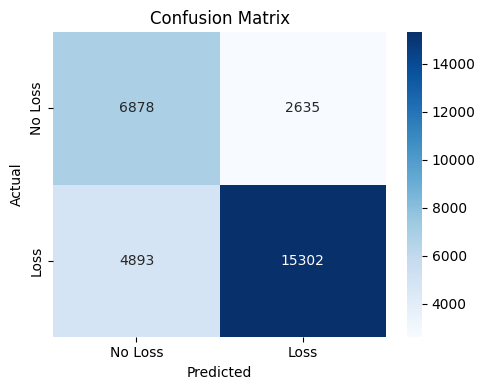

In [23]:
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score, confusion_matrix,
    mean_absolute_error, mean_squared_error, r2_score, root_mean_squared_error
)
import numpy as np

# --- Classifier Evaluation ---
print("📊 Classifier Evaluation:")

y_class_pred = classifier_model.predict(Xc_test)
y_class_probs = classifier_model.predict_proba(Xc_test)[:, 1]

print(f"Accuracy:  {accuracy_score(yc_test, y_class_pred):.4f}")
print(f" Precision: {precision_score(yc_test, y_class_pred):.4f}")
print(f" Recall:    {recall_score(yc_test, y_class_pred):.4f}")
print(f"F1 Score:  {f1_score(yc_test, y_class_pred):.4f}")
print(" Confusion Matrix:")
confusion = confusion_matrix(yc_test, y_class_pred)
# Confusion Matrix
plt.figure(figsize=(5, 4))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", xticklabels=["No Loss", "Loss"], yticklabels=["No Loss", "Loss"])
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.tight_layout()
plt.show()




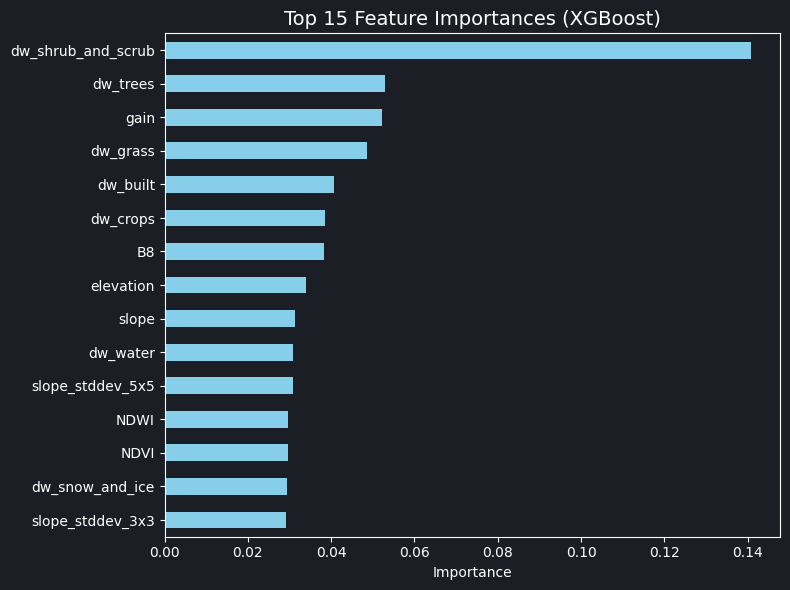

In [8]:
import matplotlib.pyplot as plt
import pandas as pd

# Prepare feature importances
importances = classifier_model.feature_importances_
feat_names = classifier_bands
feat_imp = pd.Series(importances, index=feat_names).sort_values(ascending=False)

# Plot top 15
top15 = feat_imp.head(15).sort_values()

# Styling for dark background
fig, ax = plt.subplots(figsize=(8, 6))
fig.patch.set_facecolor('#1c1e26')  # Background outside plot
ax.set_facecolor('#1c1e26')         # Background inside plot

top15.plot(kind='barh', ax=ax, color='skyblue')

# Axis + title styles
ax.set_title("Top 15 Feature Importances (XGBoost)", color='white', fontsize=14)
ax.set_xlabel("Importance", color='white')
ax.tick_params(axis='x', colors='white')
ax.tick_params(axis='y', colors='white')
ax.spines['bottom'].set_color('white')
ax.spines['top'].set_color('white')
ax.spines['left'].set_color('white')
ax.spines['right'].set_color('white')

plt.tight_layout()
plt.show()


In [ ]:
import folium
import numpy as np
from scipy.ndimage import gaussian_filter
from ipywidgets import interact, FloatSlider
from IPython.display import display

# Latitude and longitude (already extracted from your df)
lats = df["latitude"].values
lons = df["longitude"].values
display(df.head())
#  Model probabilities
probs = classifier_model.predict_proba(df[classifier_bands])[:, 1]  # Probability of deforestation
print(probs)

#  Bin configuration
lat_bins = np.linspace(48, 55, 150)
lon_bins = np.linspace(-125, -105, 150)

#  Heatmap generator function with thresholds as arguments
def generate_heatmap(thresh_1=0.3, thresh_2=0.5, thresh_3=0.7):
    #  Create 2D histogram with smoothing
    heatmap_grid, _, _ = np.histogram2d(lats, lons, bins=[lat_bins, lon_bins], weights=probs)
    counts, _, _ = np.histogram2d(lats, lons, bins=[lat_bins, lon_bins])
    avg_probs = np.divide(heatmap_grid, counts, out=np.zeros_like(heatmap_grid), where=counts != 0)
    smoothed_probs = gaussian_filter(avg_probs, sigma=1.5)

    # Create the folium map
    m = folium.Map(location=[52.5, -115], zoom_start=6, tiles='cartodbpositron')

    # Draw colored circles based on risk thresholds
    for i in range(smoothed_probs.shape[0]):
        for j in range(smoothed_probs.shape[1]):
            prob = smoothed_probs[i, j]
            if prob >= thresh_1:
                lat = (lat_bins[i] + lat_bins[i + 1]) / 2
                lon = (lon_bins[j] + lon_bins[j + 1]) / 2
                radius = prob * 15

                # Color based on thresholds
                if prob >= thresh_3:
                    color = "darkred"
                elif prob >= thresh_2:
                    color = "orangered"
                else:
                    color = "orange"

                folium.CircleMarker(
                    location=[lat, lon],
                    radius=radius,
                    color=None,
                    fill=True,
                    fill_color=color,
                    fill_opacity=0.5,
                    tooltip=f"Risk: {prob:.2f}"
                ).add_to(m)

    display(m)

# Sliders to adjust thresholds
interact(
    generate_heatmap,
    thresh_1=FloatSlider(value=0.04, min=0.0, max=1.0, step=0.01, description='Low Risk'),
    thresh_2=FloatSlider(value=0.19, min=0.0, max=1.0, step=0.01, description='Med Risk'),
    thresh_3=FloatSlider(value=0.29, min=0.0, max=1.0, step=0.01, description='High Risk'),
);



,system:index,B2,B3,B4,B8,NDVI,NDVI_2yr_delta,NDVI_stddev_3x3,NDVI_stddev_5x5,NDVI_trend,...,lossyear,recent_loss,slope,slope_stddev_3x3,slope_stddev_5x5,.geo,year,latitude,longitude,latlon
0,6,819.0,615.0,378.0,1981.0,0.679525,0.011754,0.064439,0.098470,0.632245,...,14,0,25.130798,5.520061,6.477565,"{""type"":""Point"",""coordinates"":[-121.8491555071...",2020,49.335567,-121.849156,"(49.335567404377734, -121.84915550719643)"
1,11,944.0,772.0,528.0,1881.0,0.561644,0.108143,0.044291,0.059973,0.514270,...,16,0,12.332183,2.387733,4.636631,"{""type"":""Point"",""coordinates"":[-121.9329282035...",2020,49.503605,-121.932928,"(49.50360483985205, -121.9329282035487)"
2,17,1243.0,1130.0,1067.0,2452.0,0.393578,0.033450,0.180214,0.313342,0.388843,...,6,0,0.212207,3.221693,5.412124,"{""type"":""Point"",""coordinates"":[-122.6708004807...",2020,49.284492,-122.670800,"(49.28449227641297, -122.67080048071907)"
3,19,831.0,652.0,376.0,2418.0,0.730852,0.031983,0.040522,0.055995,0.716385,...,12,0,11.275628,2.141509,3.533465,"{""type"":""Point"",""coordinates"":[-122.4157588306...",2020,49.239961,-122.415759,"(49.23996145008979, -122.41575883066744)"
4,22,967.0,803.0,582.0,2271.0,0.592008,0.027613,0.038043,0.038430,0.583321,...,15,0,2.915691,2.759305,2.667499,"{""type"":""Point"",""coordinates"":[-122.5136819166...",2020,49.146610,-122.513682,"(49.14660975732347, -122.51368191662017)"


[0.17597212 0.20186822 0.48421943 ... 0.51548755 0.54271185 0.22695015]


interactive(children=(FloatSlider(value=0.04, description='Low Risk', max=1.0, step=0.01), FloatSlider(value=0…

# LSTM Data Prep

In [3]:
import glob
import pandas as pd

# Initialize a list to hold DataFrames for all years
all_years = []

# Loop through the years and load each of the 81 tiles
for year in range(2017, 2024):
    # Use glob to get all matching tile files for the year
    tile_files = glob.glob(f"/content/drive/MyDrive/test/deforestation_tile_{year}_*.csv")
    print(tile_files)
    for file in tile_files:
        df = pd.read_csv(file)
        df["year"] = year  # Add a column for the year
        all_years.append(df)

# Concatenate all dataframes into one
df_all = pd.concat(all_years, ignore_index=True)

import json

# Extract latitude and longitude from the `.geo` field
df_all["lat"] = df_all[".geo"].apply(lambda g: json.loads(g)["coordinates"][1])
df_all["lon"] = df_all[".geo"].apply(lambda g: json.loads(g)["coordinates"][0])

# Optional: Round to 5 decimal places to ensure mergeability


year_coords = df_all.groupby("year").apply(lambda g: set(zip(g["lat"], g["lon"])))

# Compare intersection of years
years = sorted(year_coords.index.tolist())

# Initialize matrix to hold overlaps
for i in range(len(years)):
    for j in range(i + 1, len(years)):
        y1, y2 = years[i], years[j]
        overlap = len(year_coords[y1].intersection(year_coords[y2]))
        print(f"Overlap between {y1} and {y2}: {overlap} pixels")
from IPython.display import display
display(df_all.sort_values("year").groupby("year").first())

display(df_all)  # Instead of ace_tools.display_dataframe_to_user("name", df)

[]
[]
[]
['/content/drive/MyDrive/test/deforestation_tile_2020_3.csv', '/content/drive/MyDrive/test/deforestation_tile_2020_2.csv', '/content/drive/MyDrive/test/deforestation_tile_2020_1.csv', '/content/drive/MyDrive/test/deforestation_tile_2020_4.csv', '/content/drive/MyDrive/test/deforestation_tile_2020_6.csv', '/content/drive/MyDrive/test/deforestation_tile_2020_5.csv', '/content/drive/MyDrive/test/deforestation_tile_2020_8.csv', '/content/drive/MyDrive/test/deforestation_tile_2020_10.csv', '/content/drive/MyDrive/test/deforestation_tile_2020_7.csv', '/content/drive/MyDrive/test/deforestation_tile_2020_9.csv', '/content/drive/MyDrive/test/deforestation_tile_2020_11.csv', '/content/drive/MyDrive/test/deforestation_tile_2020_12.csv', '/content/drive/MyDrive/test/deforestation_tile_2020_13.csv', '/content/drive/MyDrive/test/deforestation_tile_2020_15.csv', '/content/drive/MyDrive/test/deforestation_tile_2020_14.csv', '/content/drive/MyDrive/test/deforestation_tile_2020_16.csv', '/conte

<ipython-input-3-6ac38bcb6ecf>:29: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  year_coords = df_all.groupby("year").apply(lambda g: set(zip(g["lat"], g["lon"])))


Overlap between 2020 and 2021: 39400 pixels
Overlap between 2020 and 2022: 39391 pixels
Overlap between 2020 and 2023: 39398 pixels
Overlap between 2021 and 2022: 39411 pixels
Overlap between 2021 and 2023: 39420 pixels
Overlap between 2022 and 2023: 39409 pixels


,system:index,B2,B3,B4,B8,NDVI,NDVI_2yr_delta,NDVI_stddev_3x3,NDVI_stddev_5x5,NDVI_trend,...,gain,loss,lossyear,recent_loss,slope,slope_stddev_3x3,slope_stddev_5x5,.geo,lat,lon
year,,,,,,,,,,,,,,,,,,,,,
2020,19_0,701.0,594.0,442.0,1306.0,0.494279,0.144055,0.010496,0.025228,0.405684,...,0,0,7,0,2.648090,4.760107,5.734447,"{""geodesic"":false,""type"":""Point"",""coordinates""...",49.118757,-120.272065
2021,23_0,871.0,600.0,346.0,876.0,0.433715,-0.057871,0.177487,0.243058,0.371225,...,0,0,3,0,28.455675,8.787847,13.327806,"{""geodesic"":false,""type"":""Point"",""coordinates""...",49.435413,-122.169756
2022,1940_0,1238.0,1141.0,1361.0,2876.0,0.357564,-0.024925,0.011124,0.035043,0.310745,...,0,1,6,0,2.110924,0.499062,0.619950,"{""geodesic"":false,""type"":""Point"",""coordinates""...",54.286316,-114.060215
2023,1998_0,1254.0,1089.0,1058.0,2164.0,0.343265,-0.171609,0.061572,0.053790,0.410050,...,0,1,4,0,1.225987,1.253912,1.376168,"{""geodesic"":false,""type"":""Point"",""coordinates""...",54.492928,-115.167388


,system:index,B2,B3,B4,B8,NDVI,NDVI_2yr_delta,NDVI_stddev_3x3,NDVI_stddev_5x5,NDVI_trend,...,loss,lossyear,recent_loss,slope,slope_stddev_3x3,slope_stddev_5x5,.geo,year,lat,lon
0,0_0,796.0,679.000000,651.0,1129.0,0.268539,0.011868,0.086022,0.116934,0.191267,...,1,18,1,3.765306,1.646798,1.679883,"{""geodesic"":false,""type"":""Point"",""coordinates""...",2020,49.199605,-120.227149
1,6_0,828.5,721.500000,595.5,1611.5,0.460353,0.018417,0.057537,0.045758,0.451755,...,1,19,1,11.513114,1.848262,2.666952,"{""geodesic"":false,""type"":""Point"",""coordinates""...",2020,49.062612,-119.791466
2,7_0,864.5,820.000000,703.5,1753.5,0.427350,0.088800,0.071594,0.069589,0.286772,...,0,19,1,4.229126,1.108134,1.230764,"{""geodesic"":false,""type"":""Point"",""coordinates""...",2020,49.505032,-119.971129
3,8_0,777.0,710.000000,536.0,2171.0,0.603990,0.065053,0.063789,0.088375,0.560126,...,0,19,1,32.490334,5.492636,8.686714,"{""geodesic"":false,""type"":""Point"",""coordinates""...",2020,49.235538,-119.883543
4,10_0,830.5,672.500000,484.5,1715.5,0.559545,0.051064,0.062609,0.100725,0.533125,...,1,22,0,12.960631,3.561409,3.895060,"{""geodesic"":false,""type"":""Point"",""coordinates""...",2020,49.419692,-120.644866
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
159151,1986_0,1025.0,897.000000,736.0,2076.0,0.476529,-0.037620,0.051653,0.046594,0.404440,...,0,10,0,1.103399,0.443306,0.573584,"{""geodesic"":false,""type"":""Point"",""coordinates""...",2023,54.432292,-115.120227
159152,1987_0,1144.5,832.000000,586.5,1378.5,0.403053,-0.145127,0.023699,0.026028,0.444708,...,0,12,0,1.275090,0.742683,0.640515,"{""geodesic"":false,""type"":""Point"",""coordinates""...",2023,54.311019,-115.353789
159153,1990_0,1485.0,1067.666667,944.0,2494.0,0.450844,-0.029947,0.028131,0.028952,0.443361,...,1,8,0,4.860528,1.442378,1.388561,"{""geodesic"":false,""type"":""Point"",""coordinates""...",2023,54.427800,-115.443620
159154,1992_0,1015.5,881.500000,724.0,2286.0,0.518937,0.062066,0.013651,0.029785,0.422385,...,0,16,0,0.612923,0.411829,0.369903,"{""geodesic"":false,""type"":""Point"",""coordinates""...",2023,54.403097,-114.727214


In [4]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Feature list and target
features = ['B2', 'B3', 'B4', 'B8', 'NDVI', 'NDWI', 'delta_b4', 'delta_b8', 'delta_ndvi', 'delta_ndwi',
            'elevation', 'slope', 'gain', 'NDVI_stddev_3x3', 'NDVI_stddev_5x5', 'slope_stddev_3x3',
            'slope_stddev_5x5', 'NDVI_2yr_delta', 'NDVI_trend', 'dw_water', 'dw_trees',
            'dw_grass', 'dw_flooded_vegetation', 'dw_crops', 'dw_shrub_and_scrub', 'dw_built', 'dw_bare',
            'dw_snow_and_ice', 'distance_to_roads']
target = 'loss'

# Filter only deforested pixels
df_all = df_all.sort_values(['lat', 'lon', 'year'])

#  Normalize features
scaler = MinMaxScaler()
df_all[features] = scaler.fit_transform(df_all[features])

# Check pixel sequence lengths
counts = df_all.groupby(['lat', 'lon'])['year'].nunique().value_counts()
print("Pixel sequence lengths (number of pixels by how many unique years they have):")
print(counts)

# Generate sequences per pixel
SEQ_LEN = 3
sequences = []
labels = []

grouped = df_all.groupby(['lat', 'lon'])

for _, group in grouped:
    group = group.sort_values("year")

    if group['year'].nunique() >= SEQ_LEN + 1:
        group = group.drop_duplicates(subset='year')  # Keep only one row per year
        group = group.reset_index(drop=True)

        for i in range(len(group) - SEQ_LEN):
            seq = group[features].iloc[i:i+SEQ_LEN].values
            label = group[target].iloc[i+SEQ_LEN]
            sequences.append(seq)
            labels.append(label)

# Final arrays
X = np.array(sequences)
y = np.array(labels)

print(" Input shape:", X.shape)
print(" Target shape:", y.shape)


Pixel sequence lengths (number of pixels by how many unique years they have):
year
4    39389
3       31
1       11
2        2
Name: count, dtype: int64
✅ Input shape: (39389, 3, 29)
✅ Target shape: (39389,)


# LSTM Training

In [5]:
# LSTM Model
from keras.layers import Bidirectional
from tensorflow.keras.models import Sequential
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K

from tensorflow.keras.layers import Input, LSTM, Dense, Dropout, Multiply, Permute, Activation, Lambda

from tensorflow.keras.callbacks import EarlyStopping
from sklearn.utils import class_weight
from tensorflow.keras.layers import BatchNormalization
class_weights = class_weight.compute_class_weight(
    class_weight='balanced',
    classes=np.unique(y),
    y=y
)

early_stop = EarlyStopping(
    monitor='val_loss',
    patience=10,
    restore_best_weights=True,
    verbose=1
)

NUM_FEATURES = len(features)

# --- Input ---
inputs = Input(shape=(SEQ_LEN, NUM_FEATURES))

# --- LSTM with return_sequences to keep all timesteps ---
lstm_out = Bidirectional(LSTM(64, return_sequences=True))(inputs)

# --- Attention Mechanism ---
attention_weights = Dense(1, activation='tanh')(lstm_out)         # Shape: (batch, time, 1)
attention_weights = Permute((2, 1))(attention_weights)            # Shape: (batch, 1, time)
attention_weights = Activation('softmax')(attention_weights)      # Normalize weights
attention_weights = Permute((2, 1))(attention_weights)            # Back to (batch, time, 1)

# Multiply attention weights with LSTM output
attended_lstm_out = Multiply()([lstm_out, attention_weights])     # Shape: (batch, time, features)
context_vector = Lambda(lambda x: K.sum(x, axis=1))(attended_lstm_out)  # Shape: (batch, features)

# --- Output Layer ---
x = Dropout(0.3)(context_vector)
output = Dense(1, activation='sigmoid')(x)

# --- Final Model ---
model = Model(inputs, output)




import tensorflow as tf
def binary_focal_loss(gamma=2.0, alpha=0.25):
    def focal_loss(y_true, y_pred):
        epsilon = tf.keras.backend.epsilon()
        y_pred = tf.clip_by_value(y_pred, epsilon, 1. - epsilon)
        pt = tf.where(tf.equal(y_true, 1), y_pred, 1 - y_pred)
        return -alpha * tf.pow(1. - pt, gamma) * tf.math.log(pt)
    return focal_loss

model.compile(optimizer='adam', loss=binary_focal_loss(), metrics=['accuracy'])
model.summary()

class_weights = dict(enumerate(class_weights))

# Pass to model.fit
history = model.fit(
    X, y,
    epochs=100,
    batch_size=16,
    validation_split=0.2,
    callbacks=[early_stop],
    class_weight=class_weights  #  fixes imbalance
)
# Evaluate
y_pred = model.predict(X)


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 3, 29)     │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bidirectional       │ (None, 3, 128)    │     48,128 │ input_layer[0][0] │
│ (Bidirectional)     │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, 3, 1)      │        129 │ bidirectional[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ permute (Permute)   │ (None, 1, 3)      │          0 │ dense[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 1, 3)      │          0 │ permute[0][0]     │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ permute_1 (Permute) │ (None, 3, 1)      │          0 │ activation[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply (Multiply) │ (None, 3, 128)    │          0 │ bidirectional[0]… │
│                     │                   │            │ permute_1[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda (Lambda)     │ (None, 128)       │          0 │ multiply[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout (Dropout)   │ (None, 128)       │          0 │ lambda[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_1 (Dense)     │ (None, 1)         │        129 │ dropout[0][0]     │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 48,386 (189.01 KB)

 Trainable params: 48,386 (189.01 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
1970/1970 ━━━━━━━━━━━━━━━━━━━━ 18s 7ms/step - accuracy: 0.6168 - loss: 0.0397 - val_accuracy: 0.6368 - val_loss: 0.0392
Epoch 2/100
1970/1970 ━━━━━━━━━━━━━━━━━━━━ 13s 7ms/step - accuracy: 0.6284 - loss: 0.0384 - val_accuracy: 0.6081 - val_loss: 0.0404
Epoch 3/100
1970/1970 ━━━━━━━━━━━━━━━━━━━━ 21s 7ms/step - accuracy: 0.6286 - loss: 0.0381 - val_accuracy: 0.6422 - val_loss: 0.0385
Epoch 4/100
1970/1970 ━━━━━━━━━━━━━━━━━━━━ 22s 8ms/step - accuracy: 0.6285 - loss: 0.0378 - val_accuracy: 0.6236 - val_loss: 0.0397
Epoch 5/100
1970/1970 ━━━━━━━━━━━━━━━━━━━━ 13s 7ms/step - accuracy: 0.6428 - loss: 0.0375 - val_accuracy: 0.6318 - val_loss: 0.0386
Epoch 6/100
1970/1970 ━━━━━━━━━━━━━━━━━━━━ 14s 7ms/step - accuracy: 0.6401 - loss: 0.0374 - val_accuracy: 0.5913 - val_loss: 0.0407
Epoch 7/100
1970/1970 ━━━━━━━━━━━━━━━━━━━━ 20s 7ms/step - accuracy: 0.6470 - loss: 0.0372 - val_accuracy: 0.6161 - val_loss: 0.0393
Epoch 8/100
1970/1970 ━━━━━━━━━━━━━━━━━━━━ 20s 7ms/step - accuracy: 0.6464 -

# LSTM evaluation


🔍 LSTM Evaluation Results:
Accuracy     : 0.6739
Precision    : 0.7862
Recall       : 0.6677
F1 Score     : 0.7221
ROC AUC Score: 0.7447

📝 Classification Report:
              precision    recall  f1-score   support

           0     0.5426    0.6847    0.6054     14394
           1     0.7862    0.6677    0.7221     24995

    accuracy                         0.6739     39389
   macro avg     0.6644    0.6762    0.6637     39389
weighted avg     0.6972    0.6739    0.6794     39389



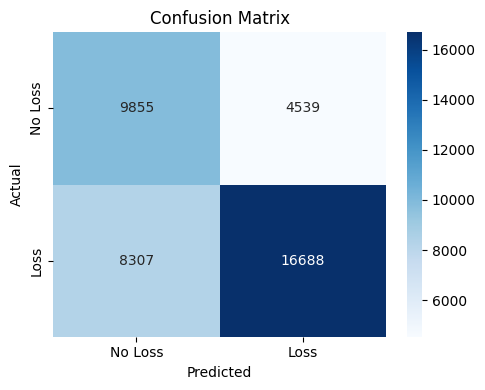

In [10]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report, roc_auc_score
import matplotlib.pyplot as plt
import seaborn as sns

# Convert probabilities to binary labels using threshold
threshold = 0.5
y_pred_prob = y_pred.flatten()
y_pred_binary = (y_pred_prob >= threshold).astype(int)

# Metrics
acc = accuracy_score(y, y_pred_binary)
prec = precision_score(y, y_pred_binary, zero_division=0)
rec = recall_score(y, y_pred_binary, zero_division=0)
f1 = f1_score(y, y_pred_binary, zero_division=0)
roc_auc = roc_auc_score(y, y_pred_prob)
cm = confusion_matrix(y, y_pred_binary)

#  Print results
print(f"\n🔍 LSTM Evaluation Results:")
print(f"Accuracy     : {acc:.4f}")
print(f"Precision    : {prec:.4f}")
print(f"Recall       : {rec:.4f}")
print(f"F1 Score     : {f1:.4f}")
print(f"ROC AUC Score: {roc_auc:.4f}")

print("\n📝 Classification Report:")
print(classification_report(y, y_pred_binary, digits=4))

# Confusion Matrix
plt.figure(figsize=(5, 4))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=["No Loss", "Loss"], yticklabels=["No Loss", "Loss"])
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.tight_layout()
plt.show()


1231/1231 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step
1231/1231 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step
Feature: B2, Drop in F1: 0.0017
1231/1231 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step
Feature: B3, Drop in F1: 0.0003
1231/1231 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step
Feature: B4, Drop in F1: 0.0023
1231/1231 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step
Feature: B8, Drop in F1: 0.0002
1231/1231 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step
Feature: NDVI, Drop in F1: 0.0002
1231/1231 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step
Feature: NDWI, Drop in F1: 0.0000
1231/1231 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
Feature: delta_b4, Drop in F1: 0.0005
1231/1231 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step
Feature: delta_b8, Drop in F1: 0.0005
1231/1231 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step
Feature: delta_ndvi, Drop in F1: 0.0005
1231/1231 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step
Feature: delta_ndwi, Drop in F1: 0.0001
1231/1231 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step
Feature: elevation, Drop in F1: 0.0014
1231/1231 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step
Feature: slope, Drop in F1: 0.0027
1231/1231 ━━━━━

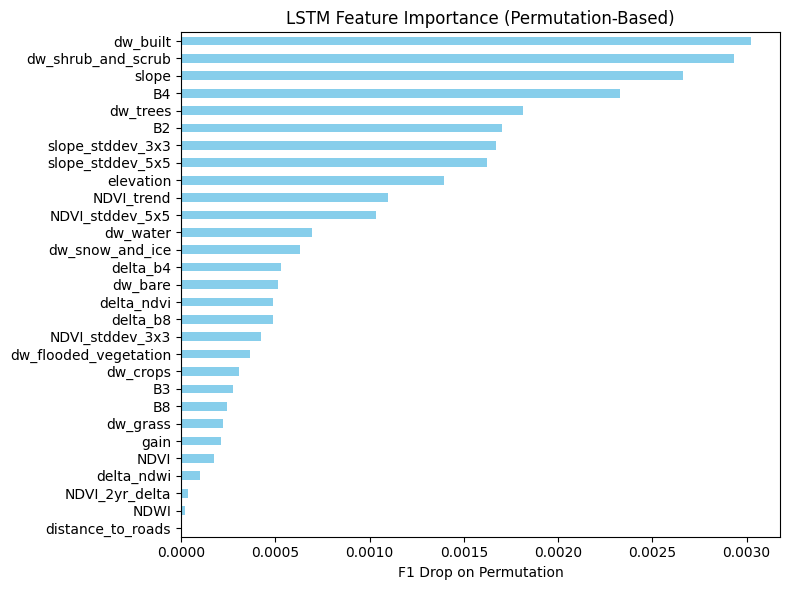

In [15]:
import numpy as np
from sklearn.metrics import f1_score


threshold = 0.43
baseline_probs = model.predict(X)
baseline_preds = (baseline_probs >= threshold).astype(int)
baseline_score = f1_score(y, baseline_preds)

# Feature importance placeholder
feature_names = features  # your feature list
n_features = X.shape[2]
perm_scores = []

# Loop over each feature
for i in range(n_features):
    X_perm = X.copy()

    # Shuffle this feature across all samples and time steps
    for t in range(X.shape[1]):  # for each time step
        np.random.shuffle(X_perm[:, t, i])

    # Predict with permuted input
    perm_probs = model.predict(X_perm)
    perm_preds = (perm_probs >= threshold).astype(int)
    perm_score = f1_score(y, perm_preds)

    # Importance = performance drop
    importance = baseline_score - perm_score
    perm_scores.append(importance)
    print(f"Feature: {feature_names[i]}, Drop in F1: {importance:.4f}")

# Plot
import matplotlib.pyplot as plt
import pandas as pd

imp_series = pd.Series(perm_scores, index=feature_names).sort_values(ascending=False)
imp_series.plot(kind="barh", figsize=(8, 6), color="skyblue")
plt.xlabel("F1 Drop on Permutation")
plt.title("LSTM Feature Importance (Permutation-Based)")
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()


In [ ]:
model.save("lstm_forest_loss_model.keras")

In [11]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import (
    confusion_matrix,
    precision_recall_curve,
    roc_curve,
    auc,
    accuracy_score,
    f1_score,
    classification_report
)

def plot_lstm_metrics(history, y_true, y_prob, threshold=0.5):
    """
    Plots training curves and evaluation metrics for a binary LSTM classifier.

    Parameters:
    - history: Keras History object from model.fit()
    - y_true: Ground truth binary labels (1D array)
    - y_prob: Predicted probabilities from model.predict()
    - threshold: Classification threshold (default = 0.5)
    """
    y_pred = (y_prob >= threshold).astype(int)

    # --- 1. Loss & Accuracy Over Epochs ---
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Val Loss')
    plt.title("Loss Over Epochs")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend()
    plt.grid(True)

    plt.subplot(1, 2, 2)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Val Accuracy')
    plt.title("Accuracy Over Epochs")
    plt.xlabel("Epoch")
    plt.ylabel("Accuracy")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # --- 2. Confusion Matrix ---
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6, 5))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=["No Loss", "Loss"], yticklabels=["No Loss", "Loss"])
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.grid(False)
    plt.tight_layout()
    plt.show()

    # --- 3. Precision-Recall Curve ---
    precision, recall, _ = precision_recall_curve(y_true, y_prob)
    plt.figure(figsize=(6, 5))
    plt.plot(recall, precision, marker='.')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # --- 4. ROC Curve ---
    fpr, tpr, _ = roc_curve(y_true, y_prob)
    roc_auc = auc(fpr, tpr)
    plt.figure(figsize=(6, 5))
    plt.plot(fpr, tpr, label=f"AUC = {roc_auc:.2f}")
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("ROC Curve")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # --- 5. Probability Distribution ---
    plt.figure(figsize=(6, 5))
    plt.hist(y_prob[y_true == 0], bins=30, alpha=0.6, label='No Loss', color='skyblue')
    plt.hist(y_prob[y_true == 1], bins=30, alpha=0.6, label='Loss', color='salmon')
    plt.xlabel("Predicted Probability")
    plt.ylabel("Frequency")
    plt.title("Probability Distribution by Class")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # --- Print Scores ---
    acc = accuracy_score(y_true, y_pred)
    f1 = f1_score(y_true, y_pred)
    print(f"\n Threshold: {threshold}")
    print(f"Accuracy: {acc:.4f}")
    print(f"F1 Score : {f1:.4f}")
    print("\nClassification Report:")
    print(classification_report(y_true, y_pred, digits=4))


1231/1231 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step


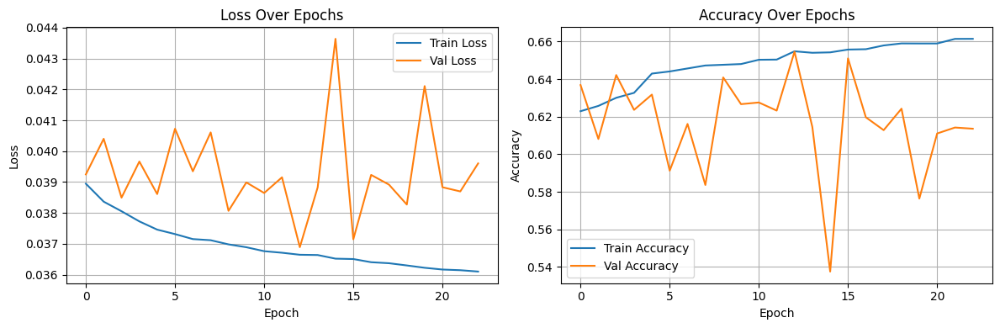

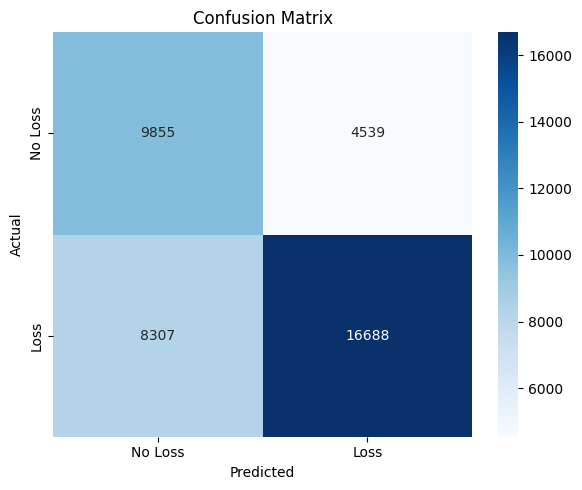

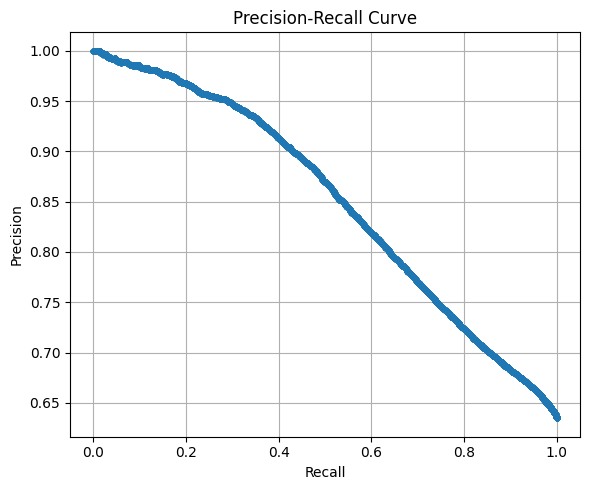

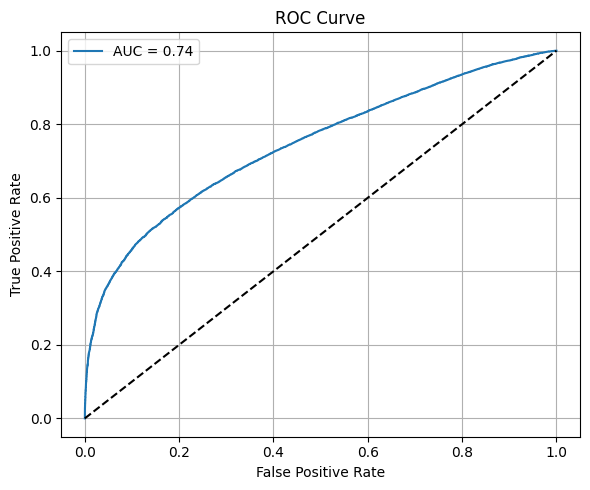

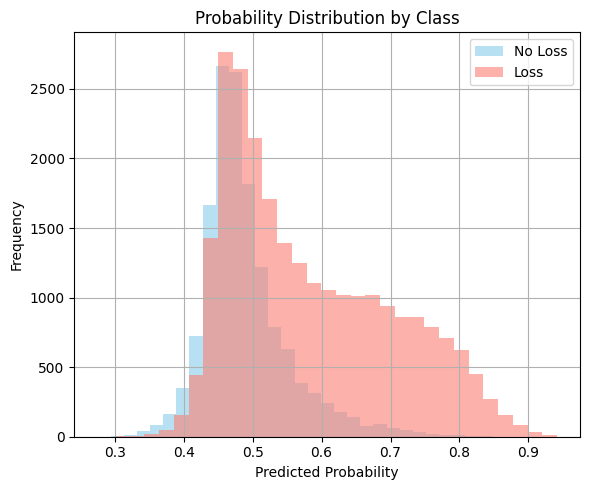


✅ Threshold: 0.5
Accuracy: 0.6739
F1 Score : 0.7221

Classification Report:
              precision    recall  f1-score   support

           0     0.5426    0.6847    0.6054     14394
           1     0.7862    0.6677    0.7221     24995

    accuracy                         0.6739     39389
   macro avg     0.6644    0.6762    0.6637     39389
weighted avg     0.6972    0.6739    0.6794     39389



In [12]:
# Predict and evaluate
y_prob = model.predict(X).flatten()
plot_lstm_metrics(history, y, y_prob, threshold=0.5)


In [46]:
from sklearn.metrics import f1_score

best_thresh = 0.5
best_f1 = 0

for t in np.arange(0.3, 0.9, 0.01):
    preds = (y_pred_prob >= t).astype(int)
    f1 = f1_score(y, preds)
    if f1 > best_f1:
        best_f1 = f1
        best_thresh = t

print(f" Best threshold: {best_thresh:.2f}, F1: {best_f1:.4f}")


✅ Best threshold: 0.44, F1: 0.7837


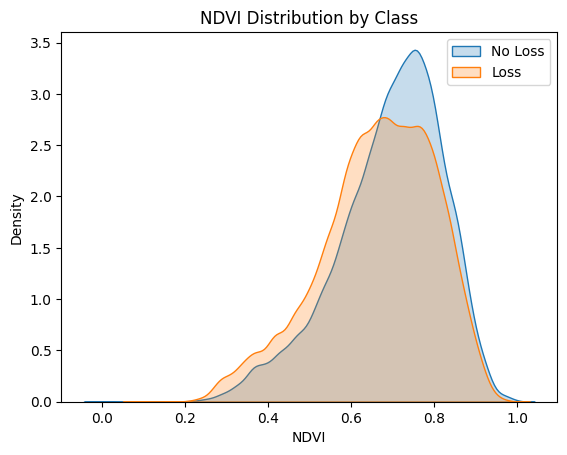

In [13]:
import seaborn as sns
import matplotlib.pyplot as plt

# Example for NDVI
sns.kdeplot(data=df_all[df_all['loss'] == 0], x='NDVI', label='No Loss', fill=True)
sns.kdeplot(data=df_all[df_all['loss'] == 1], x='NDVI', label='Loss', fill=True)
plt.title('NDVI Distribution by Class')
plt.xlabel('NDVI')
plt.legend()
plt.show()


/usr/local/lib/python3.11/dist-packages/scipy/stats/_stats_py.py:5657: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  rpb, prob = pearsonr(x, y)


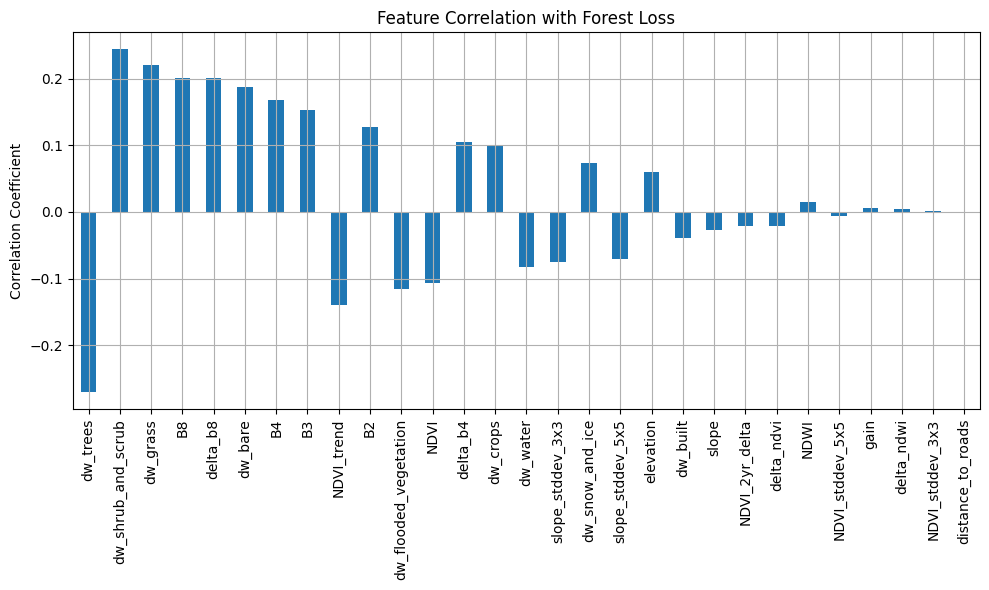

In [14]:
from scipy.stats import pointbiserialr

correlations = {}
for feature in features:
    corr, _ = pointbiserialr(df_all['loss'], df_all[feature])
    correlations[feature] = corr

# Convert to DataFrame and plot
import pandas as pd

corr_df = pd.Series(correlations).sort_values(key=abs, ascending=False)

plt.figure(figsize=(10, 6))
corr_df.plot(kind='bar')
plt.title('Feature Correlation with Forest Loss')
plt.ylabel('Correlation Coefficient')
plt.grid(True)
plt.tight_layout()
plt.show()


# LSTM Future predictions (needs refinement to data simulation for 2025+)

In [ ]:
import numpy as np
import pandas as pd

# Your defined feature list
features = ['B2', 'B3', 'B4', 'B8', 'NDVI', 'NDWI', 'delta_b4', 'delta_b8', 'delta_ndvi', 'delta_ndwi',
            'elevation', 'slope', 'gain', 'NDVI_stddev_3x3', 'NDVI_stddev_5x5', 'slope_stddev_3x3',
            'slope_stddev_5x5', 'NDVI_2yr_delta', 'NDVI_trend', 'dw_water', 'dw_trees',
            'dw_grass', 'dw_flooded_vegetation', 'dw_crops', 'dw_shrub_and_scrub', 'dw_built', 'dw_bare',
            'dw_snow_and_ice', 'distance_to_roads']

# Copy the full multi-year DataFrame to preserve original
df_seq = df_all.copy()

# Initialize list to store future predictions
all_predictions = []

# Parameters
start_year = 2024
end_year = 2030
sequence_len = 4
threshold = 0.98

# Loop over each year to predict
for target_year in range(start_year, end_year + 1):
    print(f" Predicting {target_year}...")
    sequences = []
    coords = []

    for (lat, lon), group in df_seq.groupby(['lat', 'lon']):
        group = group.sort_values("year")

        # Get last N years for this pixel
        recent_years = list(range(target_year - sequence_len, target_year))
        seq_df = group[group['year'].isin(recent_years)]

        if len(seq_df) != sequence_len:
            continue

        X_seq = seq_df[features].values
        sequences.append(X_seq)
        coords.append((lat, lon))

    # Predict loss
    X_future_seq = np.array(sequences)
    y_pred_prob = model.predict(X_future_seq)
    y_pred_binary = (y_pred_prob >= threshold).astype(int)

    # Store predictions
    predicted_df = pd.DataFrame(coords, columns=["lat", "lon"])
    predicted_df["year"] = target_year
    predicted_df["predicted_loss"] = y_pred_binary.flatten()
    all_predictions.append(predicted_df)

    # Inject predicted loss and simulate future features
    last_year_df = df_seq[df_seq["year"] == target_year - 1].copy()
    pred_rows = last_year_df.merge(predicted_df, on=["lat", "lon"])
    pred_rows["year"] = target_year
    pred_rows["loss"] = pred_rows["predicted_loss"]

    for feature in features:
        if feature in ["slope", "elevation", "distance_to_roads"]:
            continue  # static features

        if feature in ["NDVI", "NDVI_2yr_delta", "NDVI_trend", "delta_ndvi"]:
            pred_rows[feature] = pred_rows[feature] - 0.01 * pred_rows["predicted_loss"] + np.random.normal(0, 0.005, len(pred_rows))

        elif feature in ["dw_bare", "dw_built", "delta_b4", "delta_b8"]:
            pred_rows[feature] = pred_rows[feature] + 0.01 * pred_rows["predicted_loss"] + np.random.normal(0, 0.005, len(pred_rows))

        elif feature in ["dw_trees", "dw_grass", "dw_crops", "dw_shrub_and_scrub", "dw_flooded_vegetation"]:
            pred_rows[feature] = pred_rows[feature] - 0.008 * pred_rows["predicted_loss"] + np.random.normal(0, 0.004, len(pred_rows))

        elif feature in ["dw_water", "dw_snow_and_ice", "NDWI", "delta_ndwi"]:
            pred_rows[feature] = pred_rows[feature] + np.random.normal(0, 0.002, len(pred_rows))

        elif "stddev" in feature or "gain" in feature:
            pred_rows[feature] = pred_rows[feature] + np.random.normal(0, 0.003, len(pred_rows))

        else:
            pred_rows[feature] = pred_rows[feature] + np.random.normal(0, 0.004, len(pred_rows))

    # Add simulated year to sequence
    df_seq = pd.concat([df_seq, pred_rows[df_seq.columns]], ignore_index=True)

# Combine all future prediction years into one DataFrame
future_predictions_df = pd.concat(all_predictions, ignore_index=True)

print(" Done! Here's the output:")
future_predictions_df.head()




🔮 Predicting 2024...
1220/1220 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
🔮 Predicting 2025...
1220/1220 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
🔮 Predicting 2026...
1231/1231 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
🔮 Predicting 2027...
1220/1220 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
🔮 Predicting 2028...
1220/1220 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
🔮 Predicting 2029...
1220/1220 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
🔮 Predicting 2030...
1220/1220 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step
✅ Done! Here's the output:


,lat,lon,year,predicted_loss
0,48.914390,-122.639125,2024,0
1,48.914390,-113.770508,2024,0
2,48.918882,-122.490903,2024,0
3,48.921127,-113.783983,2024,0
4,48.923373,-122.273062,2024,0


In [ ]:
future_predictions_df.to_csv("lstm_predicted_loss.csv", index=False)

# LSTM Prediction Plot

In [ ]:
import folium
from folium import FeatureGroup, LayerControl
from branca.element import MacroElement
from jinja2 import Template

# Create base map
m = folium.Map(location=[
    future_predictions_df["lat"].mean(),
    future_predictions_df["lon"].mean()
], zoom_start=6)

# Create a layer for each year
years = sorted(future_predictions_df["year"].unique())

for year in years:
    layer = FeatureGroup(name=f"Year {year}", show=False if year != years[-1] else True)  # show only latest year by default
    yearly_df = future_predictions_df[(future_predictions_df["year"] == year) & (future_predictions_df["predicted_loss"] == 1)]

    for _, row in yearly_df.iterrows():
        folium.CircleMarker(
            location=[row["lat"], row["lon"]],
            radius=1,
            color="red",
            fill=True,
            fill_color="red",
            fill_opacity=0.6,
            weight=0.5,
        ).add_to(layer)

    layer.add_to(m)

# Add legend (only one needed)
legend_html = """
{% macro html(this, kwargs) %}
<div style="
    position: fixed;
    bottom: 50px;
    left: 50px;
    width: 140px;
    height: 60px;
    background-color: white;
    border:2px solid grey;
    z-index:9999;
    font-size:14px;
    padding: 10px;
">
<b>Legend:</b><br>
<span style="color:red;">●</span> Forest Loss
</div>
{% endmacro %}
"""
legend = MacroElement()
legend._template = Template(legend_html)
m.get_root().add_child(legend)

# Add layer control toggle
LayerControl(collapsed=False).add_to(m)

m


